# Poisson vs Normal approximations to Binomial

$$ Y = X_1 + X_2 + \cdots + X_n \sim \text{Binomial}(n, p)$$
$$ X_i \sim \text{Bernoulli}(p), i=1,2,3,\cdots, n
$$

Binomial distribution can be approximated in two ways. 

## Poisson approximation
* If an event is rare($p$ is small), the binomial distribution can be approximated by a Poisson distribution. 

$$
Y \sim \text{Poisson}(\lambda=np)
$$
see also 
https://en.wikipedia.org/wiki/Poisson_limit_theorem

## Normal approximation
* If the number of trials $n$ is large, the binomial distribution can be approximated by a normal distribution.
$$
Y \sim \text{N}(np, np(1-p))
$$

see also
https://en.wikipedia.org/wiki/Central_limit_theorem

# Poisson Approximation

* $\lambda = np (=1)$ remains fixed while $p\rightarrow 0.01$ and $n\rightarrow 100$

$$
Y \sim \text{Poisson}(\lambda=np)
$$

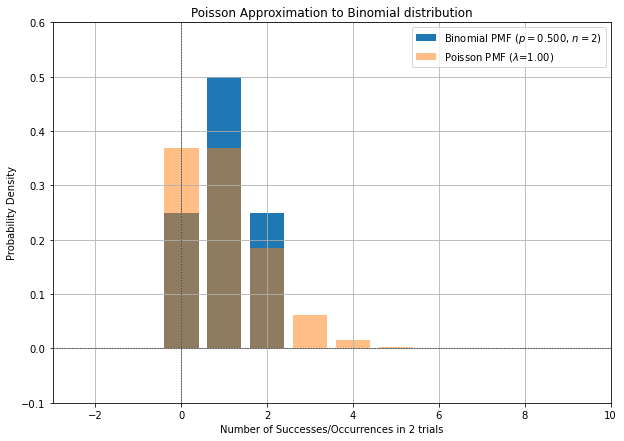

In [3]:
import scipy.stats as stats
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display


def plot(n_binomial, p_binomial):
    # Parameters for the Poisson distribution
    lambda_poisson = p_binomial * n_binomial 

    # Generate the binomial, Poisson, and normal distributions using scipy.stats
    binomial_dist = stats.binom(n_binomial, p_binomial)
    poisson_dist = stats.poisson(lambda_poisson)

    # Calculate the PMF/PDF values for each possible outcome
    x_max = int(2*p_binomial*n_binomial)+10
    x_binomial = range(0, x_max )  # Number of successes for binomial distribution
    pmf_values_binomial = binomial_dist.pmf(x_binomial)

    x_poisson = range(0, x_max)  # Number of occurrences for Poisson distribution
    pmf_values_poisson = poisson_dist.pmf(x_poisson)

    # Plot the PMFs/PDFs on the axes
    binomial = ax.bar(x_binomial, pmf_values_binomial, label=f'Binomial PMF ($p=${p_binomial:.3f}, $n=${n_binomial})')
    poisson = ax.bar(x_poisson, pmf_values_poisson, alpha=0.5, label=f'Poisson PMF ($\lambda$={lambda_poisson:.2f})')

    ax.grid(True)
    ax.legend()
    ax.axhline(0, color='black', linewidth=0.5, linestyle='dashed')  # x-axis
    ax.axvline(0, color='black', linewidth=0.5, linestyle='dashed')  # y-axis
    
    # Set labels and title
    ax.set_xlabel(f'Number of Successes/Occurrences in {n_binomial} trials', )
    ax.set_ylabel('Probability Density')
    ax.set_title('Poisson Approximation to Binomial distribution')
    
    # Fix the range of the x-axis and y-axis for consistency
    ax.set_xlim(-3, 10)
    ax.set_ylim(-0.1, 0.6)
    return binomial, poisson
    
def update(frame):
    ax.cla()  # Clear the current plot
    n_binomial = frame + 2
    p_binomial = 1/n_binomial
    binomial, poisson = plot(n_binomial, p_binomial)
    return binomial, poisson

# Set up the figure and animation
fig, ax = plt.subplots(figsize=(10, 7))
plot(2, 0.5)

ani = FuncAnimation(fig, update, frames=100, interval=100)

# Show the plot
plt.show()

# Convert the animation to HTML format and display it in the notebook
HTML(ani.to_jshtml())

# Normal Approximation

* $p=0.01$ remains fixed while $n\rightarrow 400$

$$
Y \sim \text{N}(np, np(1-p))
$$

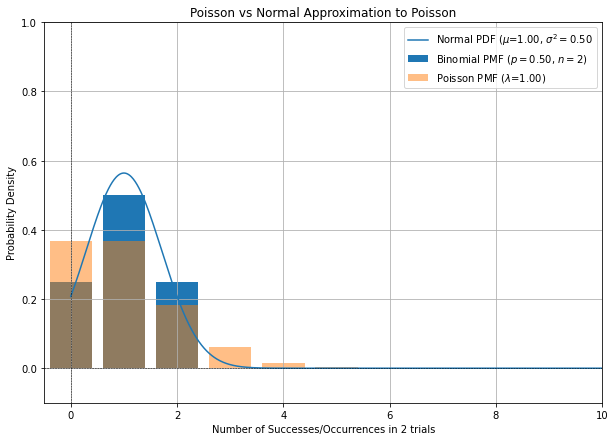

In [2]:
import scipy.stats as stats
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display


def plot(n_binomial, p_binomial):
    # Parameters for the Poisson distribution
    lambda_poisson = p_binomial * n_binomial 

    # Parameters for the normal distribution
    mean_normal = p_binomial * n_binomial
    var_normal = n_binomial * p_binomial * (1 - p_binomial)
    std_normal = np.sqrt(var_normal)

    # Generate the binomial, Poisson, and normal distributions using scipy.stats
    binomial_dist = stats.binom(n_binomial, p_binomial)
    poisson_dist = stats.poisson(lambda_poisson)
    normal_dist = stats.norm(mean_normal, std_normal)
    
    # Calculate the PMF/PDF values for each possible outcome
    x_max = int(2*p_binomial*n_binomial)+10
    x_binomial = range(0, x_max)  # Number of successes for binomial distribution
    pmf_values_binomial = binomial_dist.pmf(x_binomial)

    x_poisson = range(0, x_max)  # Number of occurrences for Poisson distribution
    pmf_values_poisson = poisson_dist.pmf(x_poisson)

    x_normal = np.linspace(0, x_max, 1000)  # Range for normal distribution
    pdf_values_normal = normal_dist.pdf(x_normal)

    # Plot the PMFs/PDFs on the axes
    binomial = ax.bar(x_binomial, pmf_values_binomial, label=f'Binomial PMF ($p=${p_binomial:.2f}, $n=${n_binomial})')
    poisson = ax.bar(x_poisson, pmf_values_poisson, alpha=0.5, label=f'Poisson PMF ($\lambda$={lambda_poisson:.2f})')
    normal = ax.plot(x_normal, pdf_values_normal, label=f'Normal PDF ($\mu$={mean_normal:.2f}, $\sigma^2=${var_normal:.2f}')

    ax.grid(True)
    ax.legend()
    ax.axhline(0, color='black', linewidth=0.5, linestyle='dashed')  # x-axis
    ax.axvline(0, color='black', linewidth=0.5, linestyle='dashed')  # y-axis
    
    # Set labels and title
    ax.set_xlabel(f'Number of Successes/Occurrences in {n_binomial} trials', )
    ax.set_ylabel('Probability Density')
    ax.set_title('Poisson vs Normal Approximation to Poisson')
    
    # Fix the range of the x-axis and y-axis for consistency
    ax.set_xlim(-0.5, 10)
    ax.set_ylim(-0.1, 1.0)
    
    return binomial, poisson, normal

def update(frame):
    ax.cla()  # Clear the current plot
    n_binomial = frame + 1
    p_binomial = 0.01
    binomial, poisson, normal = plot(n_binomial, p_binomial)
    return binomial, poisson, normal

# Set up the figure and animation
fig, ax = plt.subplots(figsize=(10, 7))
plot(2, 0.5)

ani = FuncAnimation(fig, update, frames=400, interval=50)

# Show the plot
plt.show()

# Convert the animation to HTML format and display it in the notebook
HTML(ani.to_jshtml())